In [1]:
import pickle 

with open(r"C:\Users\deela\Downloads\processed-master-all.pickle", 'rb') as f:
    data = pickle.load(f)

    print(data)

[{'lat': 20.3, 'lon': -67.7, 'slp': 1007.0, 'TOPlat': 20.3, 'TOPlon': -67.7, 'TOPtime': datetime.datetime(1998, 8, 22, 10, 47), 'BOTTOMlat': nan, 'BOTTOMlon': nan, 'BOTTOMtime': nan, 'MBLdir': nan, 'MBLspd': nan, 'DLMdir': nan, 'DLMspd': nan, 'WL150dir': nan, 'WL150spd': nan, 'top': np.float64(496.0), 'LSThgt': nan, 'software': nan, 'levels':        pres     hgt       temp       dwpt        wdir   wspd
0     500.0  5870.0  -4.300000  -5.800000  185.000000  18.00
1     501.0  5860.0  -4.247826  -5.782609  185.075000  18.05
2     502.0  5840.0  -4.195652  -5.765217  185.150000  18.10
3     503.0  5830.0  -4.143478  -5.747826  185.225000  18.15
4     504.0  5820.0  -4.091304  -5.730435  185.300000  18.20
..      ...     ...        ...        ...         ...    ...
503  1003.0    30.0  27.657143  22.828571  192.142857  24.00
504  1004.0    30.0  27.742857  22.871429  192.857143  24.00
505  1005.0    20.0  27.828571  22.914286  193.571429  24.00
506  1006.0    10.0  27.914286  22.957143  19

In [2]:
print(len(data))
print(data[0])
print('\n')
print(list(data[0].keys()))
print(data[0]['levels'])

21306
{'lat': 20.3, 'lon': -67.7, 'slp': 1007.0, 'TOPlat': 20.3, 'TOPlon': -67.7, 'TOPtime': datetime.datetime(1998, 8, 22, 10, 47), 'BOTTOMlat': nan, 'BOTTOMlon': nan, 'BOTTOMtime': nan, 'MBLdir': nan, 'MBLspd': nan, 'DLMdir': nan, 'DLMspd': nan, 'WL150dir': nan, 'WL150spd': nan, 'top': np.float64(496.0), 'LSThgt': nan, 'software': nan, 'levels':        pres     hgt       temp       dwpt        wdir   wspd
0     500.0  5870.0  -4.300000  -5.800000  185.000000  18.00
1     501.0  5860.0  -4.247826  -5.782609  185.075000  18.05
2     502.0  5840.0  -4.195652  -5.765217  185.150000  18.10
3     503.0  5830.0  -4.143478  -5.747826  185.225000  18.15
4     504.0  5820.0  -4.091304  -5.730435  185.300000  18.20
..      ...     ...        ...        ...         ...    ...
503  1003.0    30.0  27.657143  22.828571  192.142857  24.00
504  1004.0    30.0  27.742857  22.871429  192.857143  24.00
505  1005.0    20.0  27.828571  22.914286  193.571429  24.00
506  1006.0    10.0  27.914286  22.95714

In [36]:
dataList = []
radRMW = []
bprs = []
fprs = []
vprs = []
tmp = []
dew = []
wspd = []
name = []
time = []
dprt = []
for x in range(len(data)):
    try:
        temp1 = data[x]['levels']
        temp1 = temp1[temp1['pres'].between(695, 705)]
        temp1 = temp1.loc[(temp1['pres'] - 700).abs().idxmin()]
        temp2 = data[x]['bindata']
        
        tmp.append(temp1['temp'])
        dew.append(temp1['dwpt'])
        fprs.append(temp1['pres'])
        wspd.append(temp1['wspd'])
        name.append(data[x]['stormname'])
        time.append(data[x]['TOPtime'])

        radRMW.append(temp2['sonde_radius/flrmw'])
        bprs.append(temp2['bt_pressure'])
        vprs.append(temp2['vdm_pressure'].to_numpy()[0])
        dprt.append(temp2['bt_deepening_rate_ph'])
    except:
        pass

In [95]:
import numpy as np 
from helper import thetae 

dataset = np.array([name, time, radRMW, bprs, fprs, tmp, dew, wspd, vprs, dprt], dtype = 'object')

lim = 1000

dataset = dataset[:, dataset[2] < 0.5]
dataset = dataset[:, dataset[-1] < lim]
# dataset = dataset[:, (dataset[5] - dataset[6]) >= 0]
n = dataset[-2].astype(float)
n = ((np.nanmax(n) - n) / (np.nanmax(n) - np.nanmin(n))) * 100

print(dataset.shape)

thte = thetae(dataset[5].astype(float) + 273.15, dataset[4].astype(float), 1000, dataset[6].astype(float) + 273.15, dew = True)


(10, 2234)


C:\Users\deela\AppData\Local\Temp\ipykernel_5024\1225392068.py:8: RuntimeWarning: invalid value encountered in less
  dataset = dataset[:, dataset[2] < 0.5]


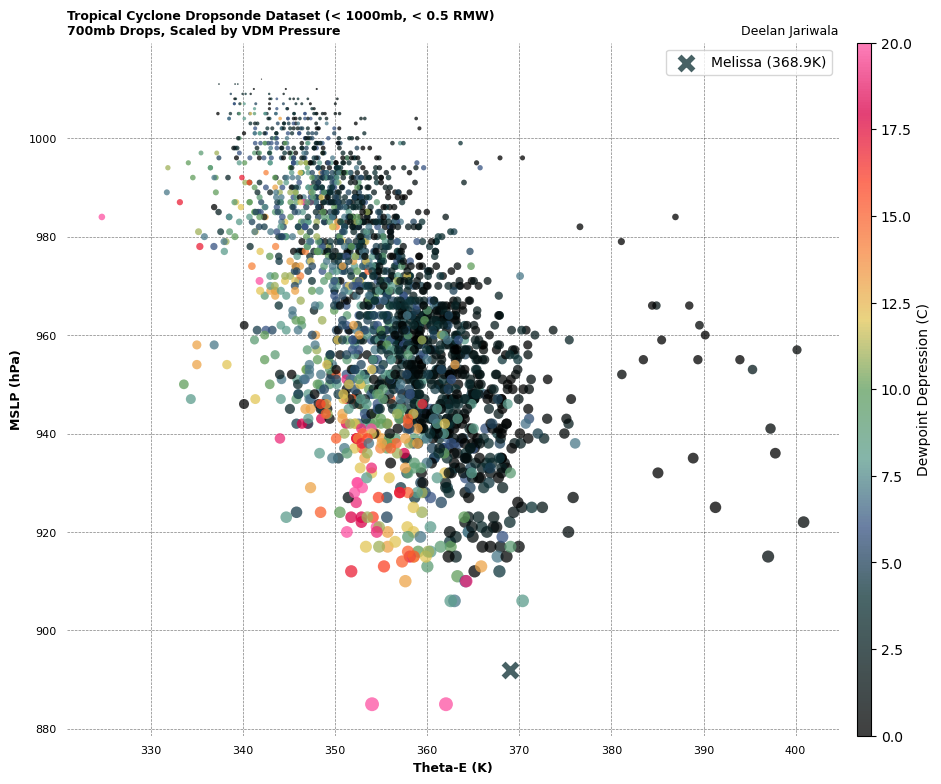

In [108]:
import matplotlib.pyplot as plt  # Plotting library
import cmaps as cmaps 

fig = plt.figure(figsize = (12, 9))
ax = plt.axes()

ax.set_frame_on(False)

ax.tick_params(axis='both', labelsize=8, left = False, bottom = False)
ax.grid(linestyle = '--', alpha = 0.5, color = 'black', linewidth = 0.5, zorder = 9)
ax.set_xlabel('Theta-E (K)', weight = 'bold', size = 9)
ax.set_ylabel('MSLP (hPa)', weight = 'bold', size = 9)
# if np.nanmax(anad[:, 1:]) > 0 and np.nanmin(anad[:, 1:]) < 0:
# ax.axhline(0, linewidth = 2, color = '#000000')
# ax.axvline(0, linewidth = 2, color = '#000000')
# ax.set_xlim(-1, 35)
# ax.set_ylim(-10, 25)

# ax.plot(np.arange(50), linewidth = 2, color = "black", zorder = 4, alpha = 0.5)
c = ax.scatter(thte, dataset[8], c = dataset[5] - dataset[6], s = n, cmap = cmaps.probs4(), zorder = 5, linewidths = 0, alpha = 0.75, vmin = 0, vmax = 20)
# c = ax.scatter(thte, dataset[8], c = dataset[-1], s = n, cmap = cmaps.tempAnoms3(), vmin = -5, vmax = 5, zorder = 5, linewidths = 0, alpha = 0.75)

t = 18.87 
d = 15.202 
p = 700 
te = thetae(t + 273.15, p, 1000, d + 273.15, dew = True)

ax.scatter(te, 892, c = t - d, s = 100, marker = 'x', zorder = 10, linewidths = 4, alpha = 0.75, cmap = cmaps.probs4(), label = f'Melissa ({str(round(te, 1))}K)', vmin = 0, vmax = 20)
ax.legend(loc = 'upper right')

cbar = plt.colorbar(c, orientation = 'vertical', aspect = 50, pad = .02)
cbar.set_label('Dewpoint Depression (C)')

ax.set_title(f'Tropical Cyclone Dropsonde Dataset (< {lim}mb, < 0.5 RMW)\n700mb Drops, Scaled by VDM Pressure', fontweight='bold', fontsize=9, loc='left')
ax.set_title(f'Deelan Jariwala', fontsize=9, loc='right')
# plt.savefig(r"C:\Users\deela\Downloads\DropsOther4.png", dpi = 300, bbox_inches = 'tight')
plt.show()


In [104]:
for x in range(len(dataset[0])):
    if thte[x] > 390:
        print(dataset[0][x], dataset[-2][x], round(thte[x], 1), round(dataset[5][x], 1), round(dataset[6][x], 1), dataset[1][x])

MARIA 953.0 395.3 23.0 20.9 2017-09-23 11:40:00
FLORENCE 955.0 394.0 16.4 22.1 2018-09-13 23:08:00
FLORENCE 957.0 400.2 22.6 22.0 2018-09-14 01:34:00
MICHAEL 936.0 397.8 17.6 22.6 2018-10-10 10:50:00
MICHAEL 925.0 391.3 18.0 21.2 2018-10-10 15:11:00
MICHAEL 922.0 400.9 22.8 22.1 2018-10-10 15:59:00
DORIAN 915.0 397.0 22.4 21.4 2019-09-02 03:25:00
DORIAN 941.0 397.3 22.2 21.5 2019-09-02 19:07:00
DORIAN 960.0 390.2 15.2 21.6 2019-09-05 11:18:00


In [ ]:
t = 18.4 + 273.15
d = 14.7 + 273.15
p = 691 
print(thetae(t, p, 1000, d, dew = True))

t = 18.87 + 273.15
d = 15.202 + 273.15
p = 700 
print(thetae(t, p, 1000, d, dew = True))

t = 18.8 + 273.15
d = 15.1 + 273.15
p = 700
print(thetae(t, p, 1000, d, dew = True))